In [1]:

import pandas as pd
import numpy as np
import seaborn as sns


import matplotlib.pyplot as plt
import datetime as dt

plt.style.use('seaborn-deep')

%matplotlib inline

sns.set()


In [2]:
df = df_total = pd.read_csv("../../../Data/DataRaw/set_kills.csv")
df_addressDate = pd.read_csv("../../../Data/DataRework/set_addressDate.csv")
df = df.drop(columns="Unnamed: 0")

In [3]:
df

,Address,Team,Time,Victim,Killer,Assist_1,Assist_2,Assist_3,Assist_4,x_pos,y_pos,Date
0,http://matchhistory.na.leagueoflegends.com/en/...,bKills,10.820,C9 Hai,TSM Bjergsen,NaN,NaN,NaN,NaN,9229,8469,1/24/2015
1,http://matchhistory.na.leagueoflegends.com/en/...,bKills,16.286,C9 LemonNation,TSM WildTurtle,TSM Santorin,TSM Bjergsen,TSM Lustboy,NaN,13908,5960,1/24/2015
2,http://matchhistory.na.leagueoflegends.com/en/...,bKills,18.733,C9 Hai,TSM Bjergsen,TSM Santorin,TSM WildTurtle,TSM Lustboy,NaN,8281,7889,1/24/2015
3,http://matchhistory.na.leagueoflegends.com/en/...,bKills,18.880,C9 Meteos,TSM Dyrus,TSM Santorin,TSM Bjergsen,TSM WildTurtle,TSM Lustboy,8522,8895,1/24/2015
4,http://matchhistory.na.leagueoflegends.com/en/...,bKills,27.005,C9 Balls,TSM Bjergsen,TSM Dyrus,TSM Santorin,TSM WildTurtle,TSM Lustboy,8902,7643,1/24/2015
...,...,...,...,...,...,...,...,...,...,...,...,...
191064,https://matchhistory.na.leagueoflegends.com/en...,rKills,35.086,TTC Papryze,LGC Claire,LGC Ceres,LGC Sybol,LGC Raid,LGC Decoy,6424,9256,1/28/2018
191065,https://matchhistory.na.leagueoflegends.com/en...,rKills,40.706,TTC Low,LGC Raid,LGC Ceres,LGC Sybol,LGC Decoy,NaN,1464,2974,1/28/2018
191066,https://matchhistory.na.leagueoflegends.com/en...,rKills,40.711,TTC Swathe,LGC Claire,LGC Ceres,LGC Sybol,LGC Raid,LGC Decoy,1014,4828,1/28/2018
191067,https://matchhistory.na.leagueoflegends.com/en...,rKills,41.113,TTC Tilting,LGC Claire,LGC Ceres,LGC Sybol,NaN,NaN,693,2924,1/28/2018


df

In [4]:

df["Date"] = pd.to_datetime(df["Date"])

df = df.drop(index = df[df.x_pos == 'TooEarly'].index)
df = df.drop(index = df[df.x_pos.isna()].index)

df.x_pos = df['x_pos'].astype('int64')
df.y_pos = df['y_pos'].astype('int64')

df_position = df[["Team","Time","x_pos","y_pos"]]


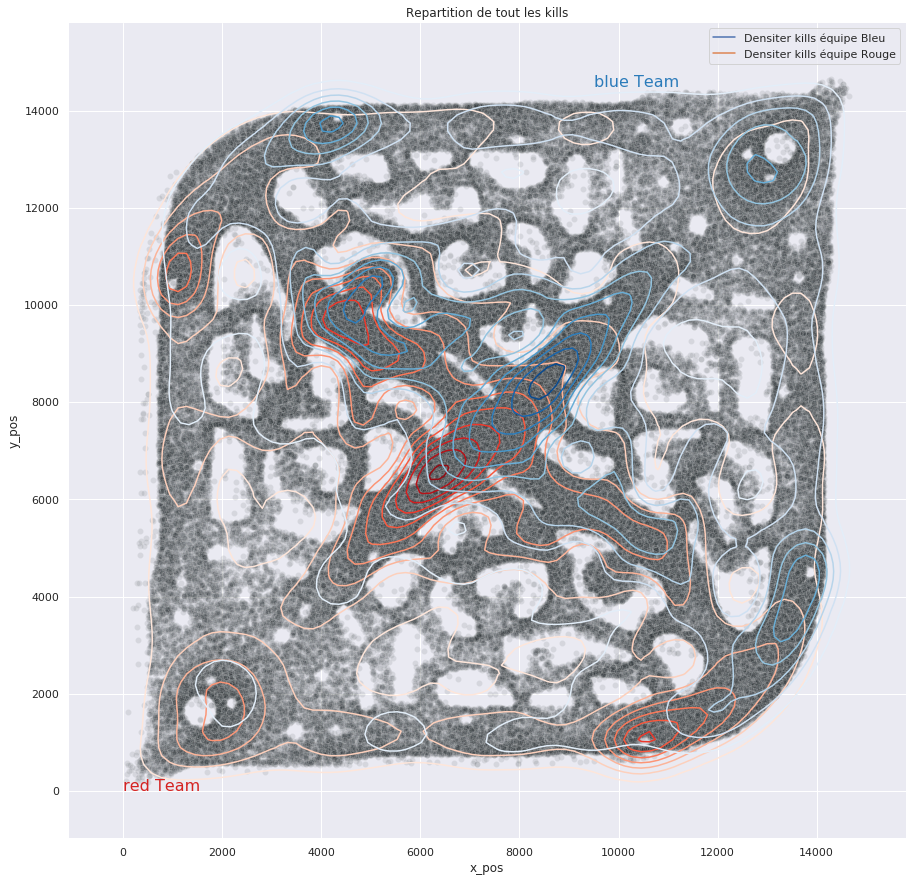

In [11]:

f, ax = plt.subplots(figsize=(15,15))
plt.title("Repartition de tout les kills")
plt.xlabel("Position en X")
plt.ylabel("Position en Y")
# Subset data
red_team = df_position.query("Team == 'rKills'")
blue_team = df_position.query("Team == 'bKills'")


sns.despine(f, left=True, bottom=True)
                     
# flatui = ["#0683FD","#e74c3c"]
flatui = ["#21282c","#e74c3c"]

        
#Draw Scatterplot
# sns.scatterplot(x="x_pos", y="y_pos",
#                 hue="Team", palette=flatui, data=df_position, ax=ax, alpha=0.1)



sns.scatterplot(x="x_pos", y="y_pos", color="#21282c", data=df_position, ax=ax, alpha=0.1)

# Draw the two density plots
ax = sns.kdeplot(red_team.x_pos, red_team.y_pos,
                 cmap="Reds", label="Densiter kills équipe Bleu")

ax = sns.kdeplot(blue_team.x_pos, blue_team.y_pos,
                 cmap="Blues", label="Densiter kills équipe Rouge")

# # Add labels to the plot
red = sns.color_palette("Reds")[-2]
blue = sns.color_palette("Blues")[-2]
ax.text(9500, 14500, "blue Team", size=16, color=blue)
ax.text(3.8, 4.5, "red Team", size=16, color=red)
plt.legend()
plt.savefig("../../../repartitionKills.png")
plt.show()


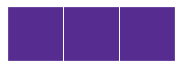

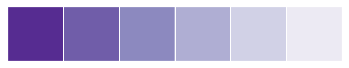

In [6]:

sns.palplot(sns.color_palette("{}".format("Purples"))[-1])
sns.palplot(sns.color_palette("{}".format("Purples_r")))


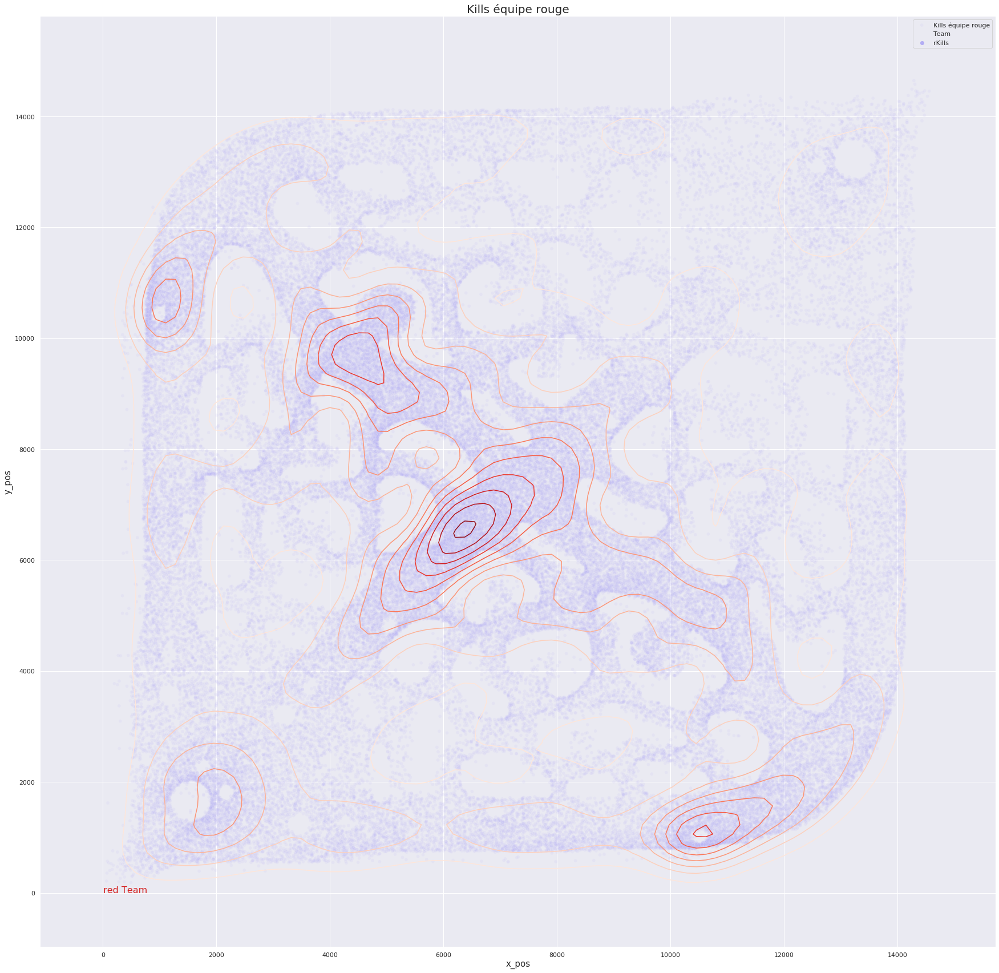

In [7]:

f, ax = plt.subplots(figsize=(30,30))
plt.title("Kills équipe rouge", fontsize=20)
plt.xlabel("Position x",fontsize=15)
plt.ylabel("Position Y",fontsize=15)



sns.despine(f, left=True, bottom=True)
                     
flatui = ["#B3ADF4"]
                     
sns.scatterplot(x="x_pos", y="y_pos",
                hue="Team", palette=flatui, data=df_position[df_position.Team == "rKills"], ax=ax,label="Kills équipe rouge", alpha=0.1)

red_team = df_position.query("Team == 'rKills'")


# Draw the two density plots
ax = sns.kdeplot(red_team.x_pos, red_team.y_pos,
                 cmap="Reds")


red = sns.color_palette("Reds")[-2]
ax.text(3.8, 4.5, "red Team", size=16, color=red)

plt.savefig("killr.png")
plt.show()

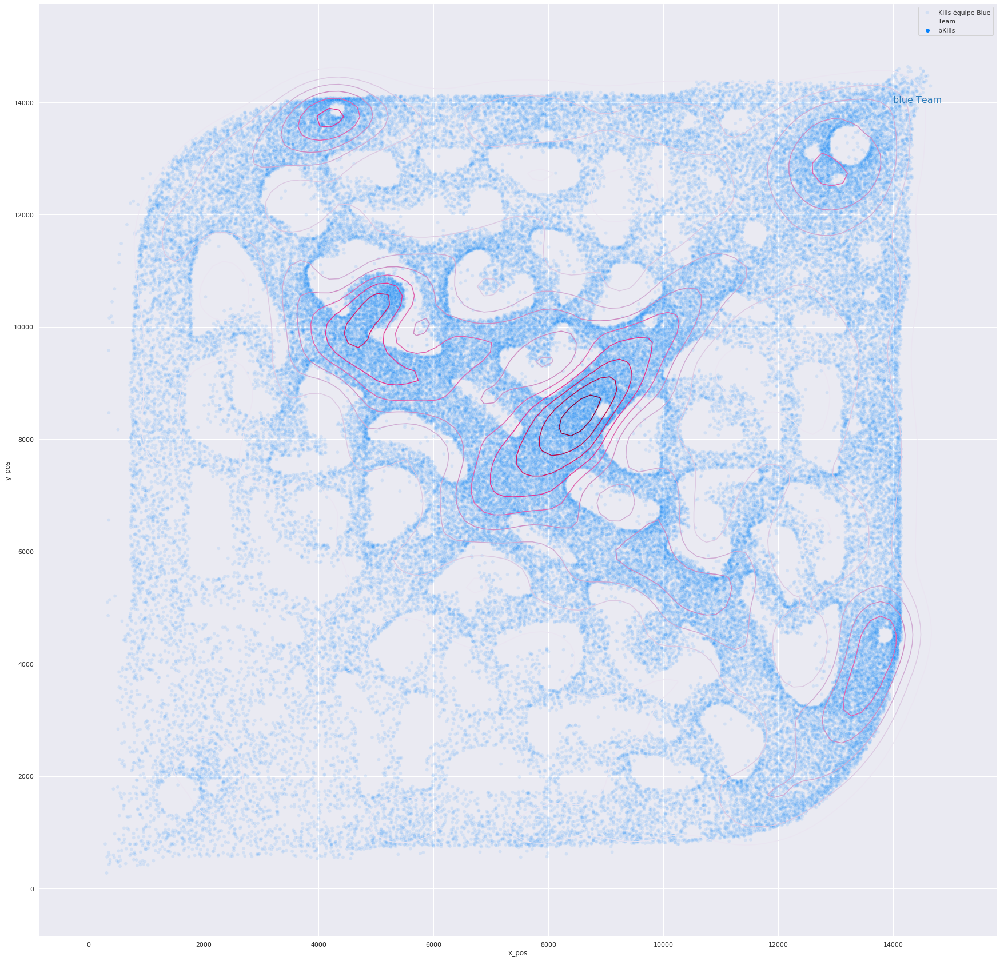

In [8]:

f, ax = plt.subplots(figsize=(30,30))

sns.despine(f, left=True, bottom=True)
                     
flatui = ["#0683FD"]
                     
sns.scatterplot(x="x_pos", y="y_pos",
                hue="Team", palette=flatui, data=df_position[df_position.Team == "bKills"], ax=ax,label="Kills équipe Blue" , alpha=0.1)

blue_team = df_position.query("Team == 'bKills'")


ax = sns.kdeplot(blue_team.x_pos, blue_team.y_pos,
                 cmap="PuRd")

blue = sns.color_palette("Blues")[-2]
ax.text(14000, 14000, "blue Team", size=16, color=blue)




plt.savefig("killb.png")
plt.show()

Text(3.8, 4.5, 'red Team')

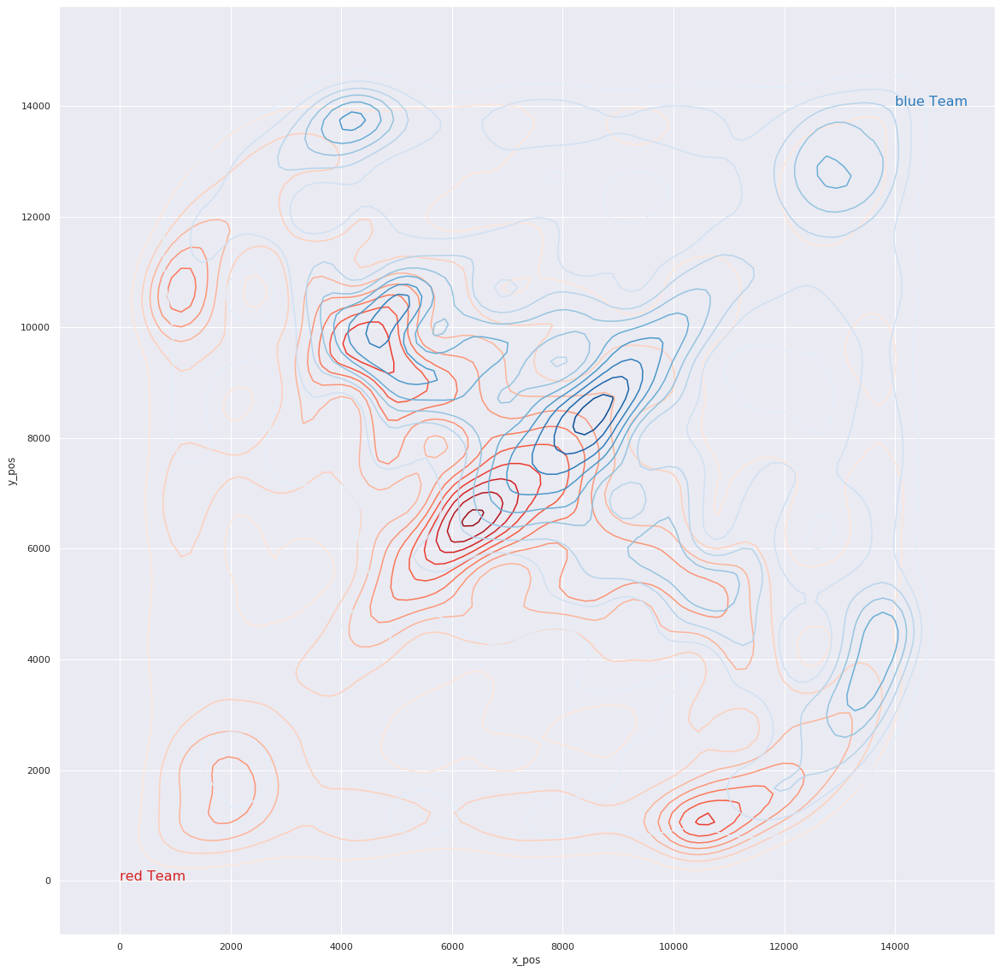

In [9]:
# Subset the iris dataset by species
red_team = df_position.query("Team == 'rKills'")
blue_team = df_position.query("Team == 'bKills'")

# Set up the figure
f, ax = plt.subplots(figsize=(20,20))
ax.set_aspect("equal")

# Draw the two density plots
ax = sns.kdeplot(red_team.x_pos, red_team.y_pos,
                 cmap="Reds")

ax = sns.kdeplot(blue_team.x_pos, blue_team.y_pos,
                 cmap="Blues")

# # Add labels to the plot
red = sns.color_palette("Reds")[-2]
blue = sns.color_palette("Blues")[-2]
ax.text(14000, 14000, "blue Team", size=16, color=blue)
ax.text(3.8, 4.5, "red Team", size=16, color=red)

In [10]:
# to do, kills position toute les 5 min de jeu.

In [11]:
df.Time.max()

94.536

In [12]:
df.Time.min()

0.845

In [13]:
df.Time.mean()

24.545015621806844

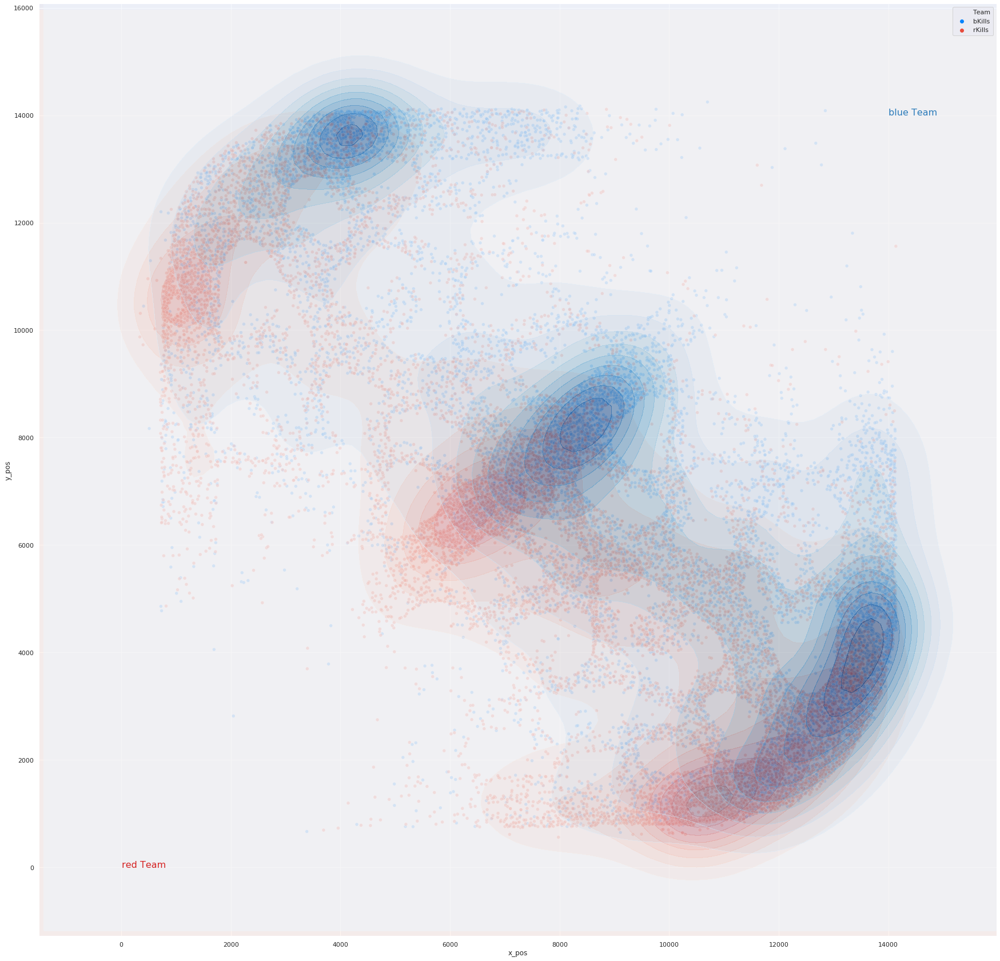

In [14]:
df_test = df_position[(df_position["Time"] <= 15.00) & (df_position["Time"] > 10.00 )]

red_team = df_test.query("Team == 'rKills'")
blue_team = df_test.query("Team == 'bKills'")

f, ax = plt.subplots(figsize=(30,30))
sns.despine(f, left=True, bottom=True)
flatui = ["#0683FD","#e74c3c"]

sns.scatterplot(x="x_pos", y="y_pos",hue="Team", palette=flatui, data=df_test, ax=ax, alpha=0.5)

# Draw the two density plots
ax = sns.kdeplot(red_team.x_pos, red_team.y_pos,
                 cmap="Reds",shade=True,alpha=0.5)

ax = sns.kdeplot(blue_team.x_pos, blue_team.y_pos,
                 cmap="Blues",shade=True,alpha=0.5)

# # Add labels to the plot
red = sns.color_palette("Reds")[-2]
blue = sns.color_palette("Blues")[-2]
ax.text(14000, 14000, "blue Team", size=16, color=blue)
ax.text(3.8, 4.5, "red Team", size=16, color=red)

plt.show()

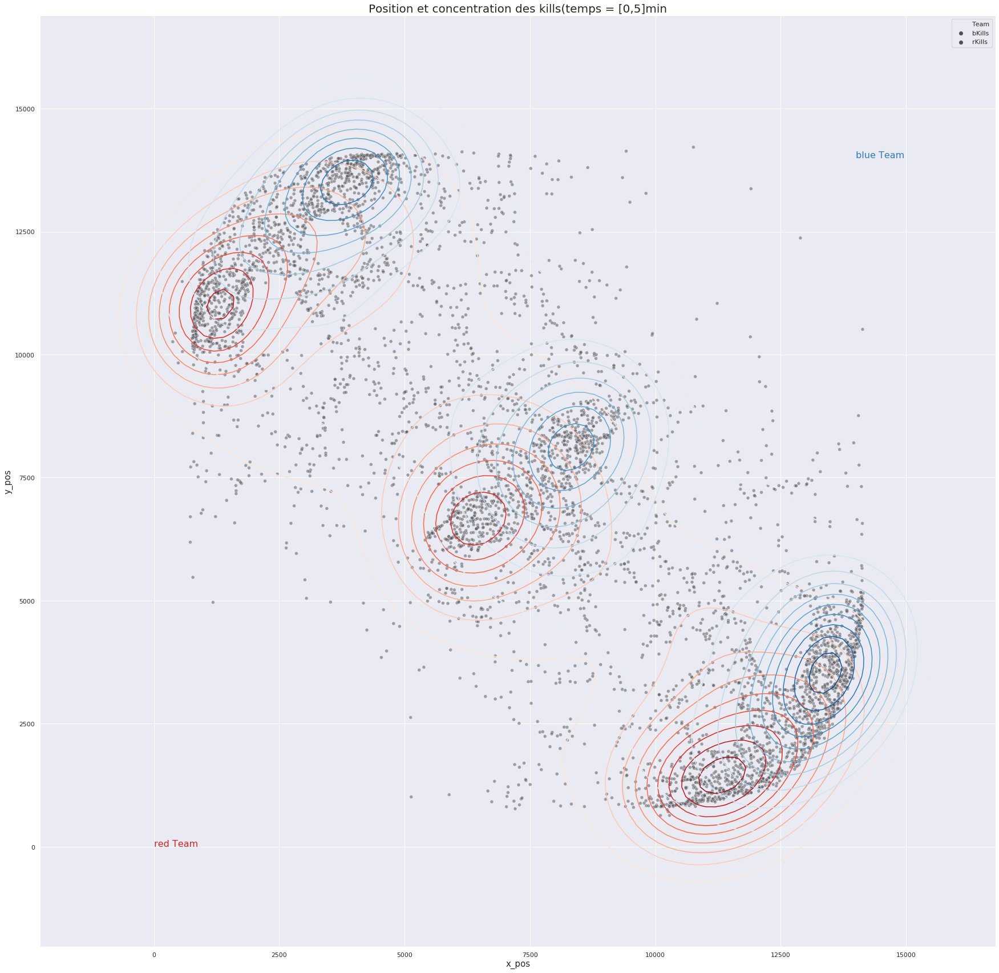

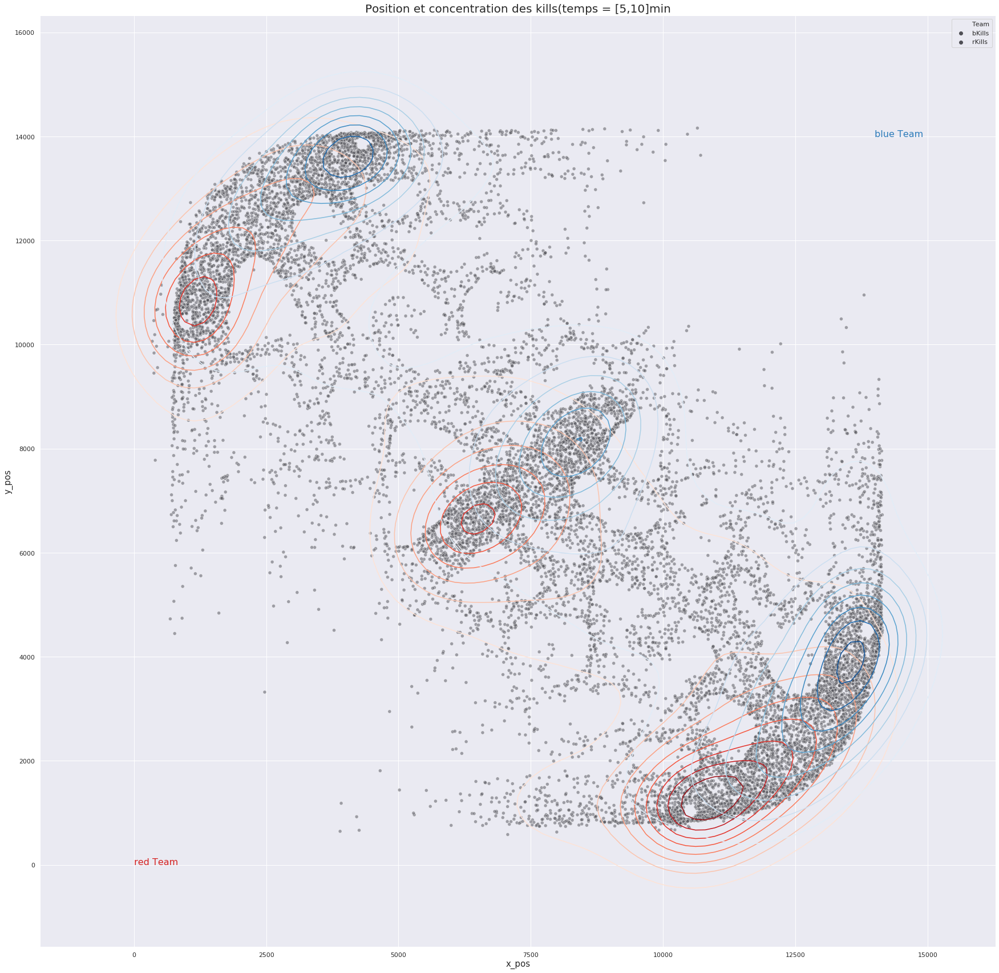

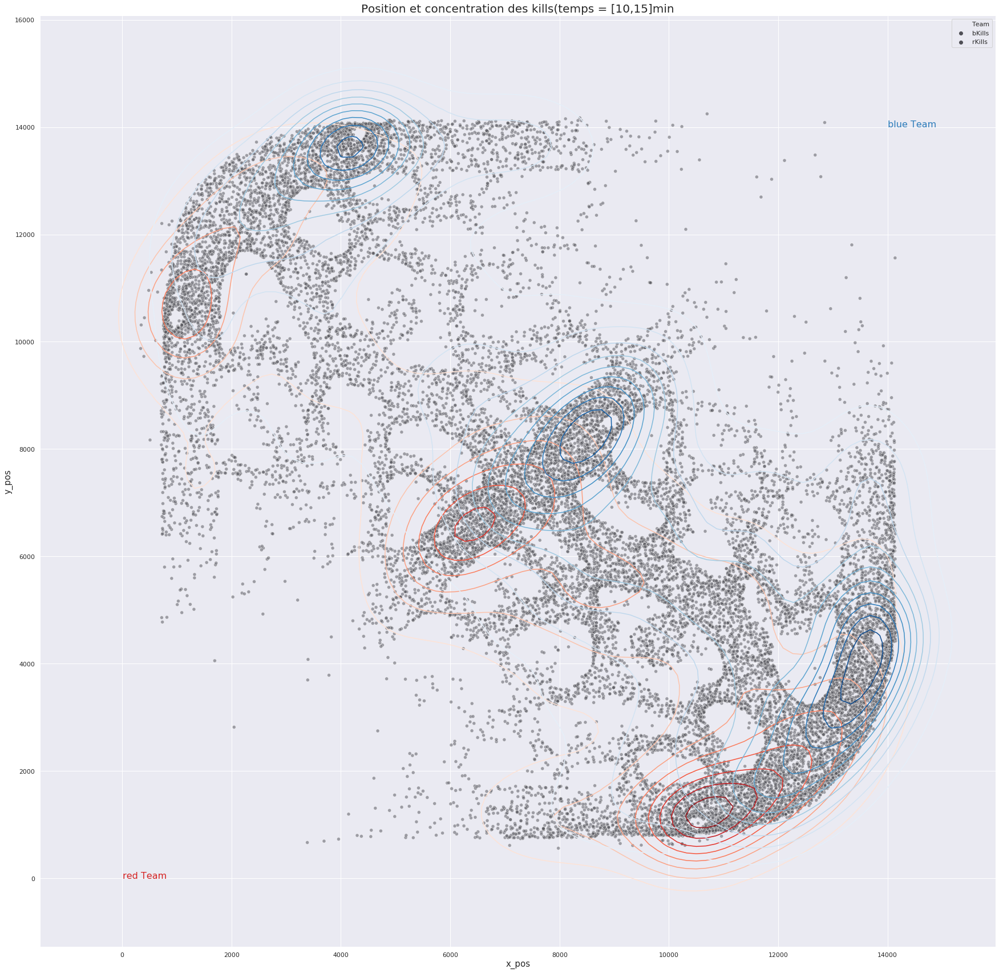

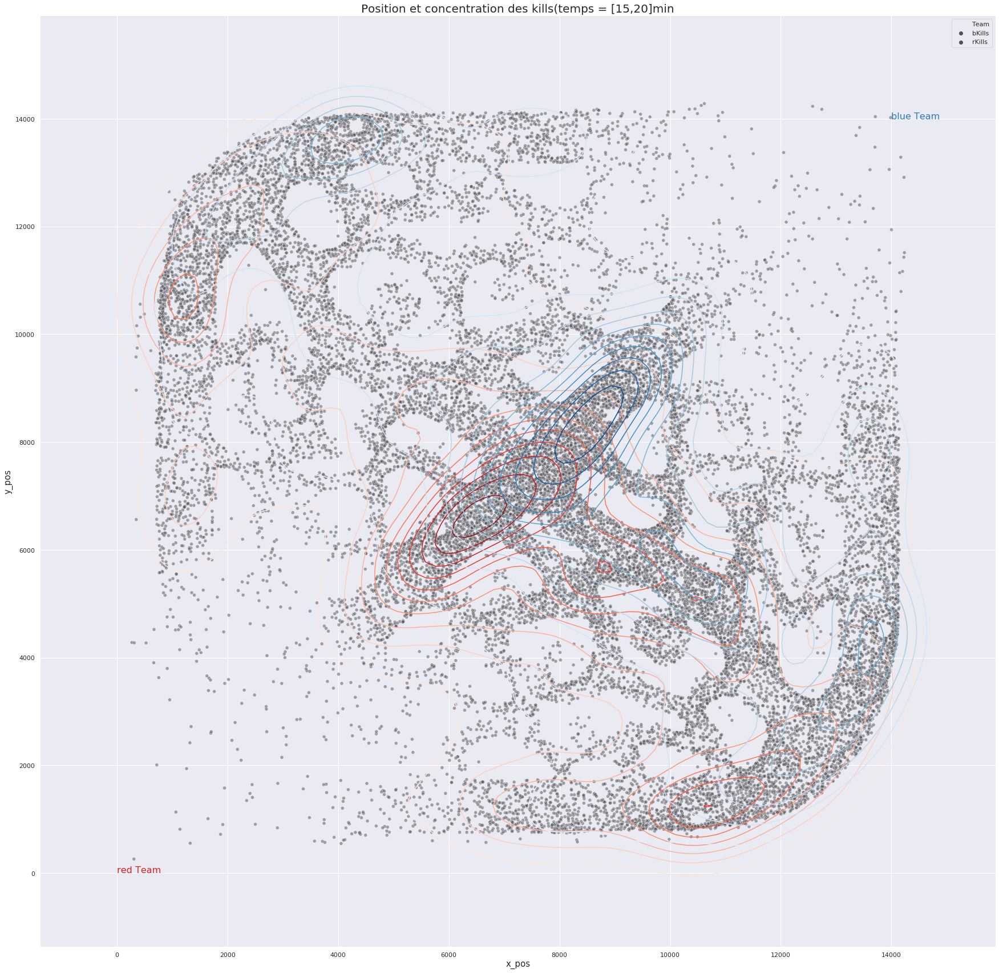

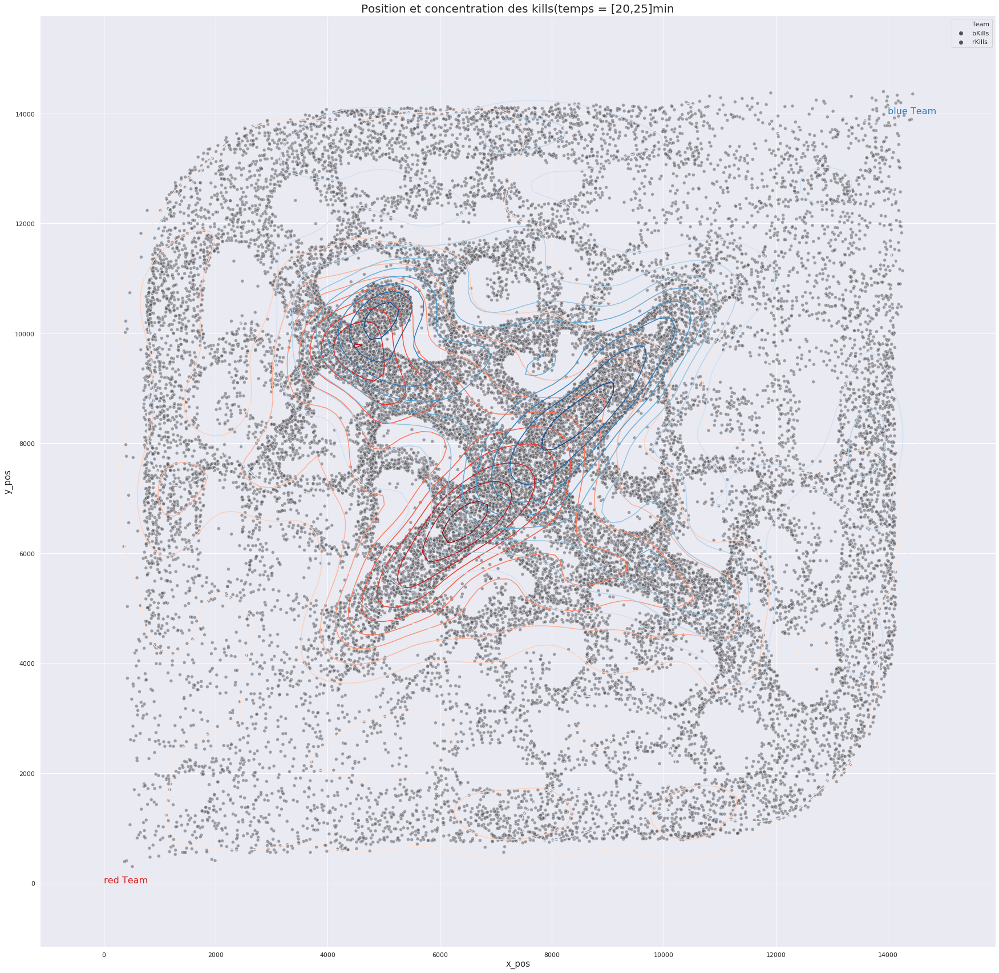

...

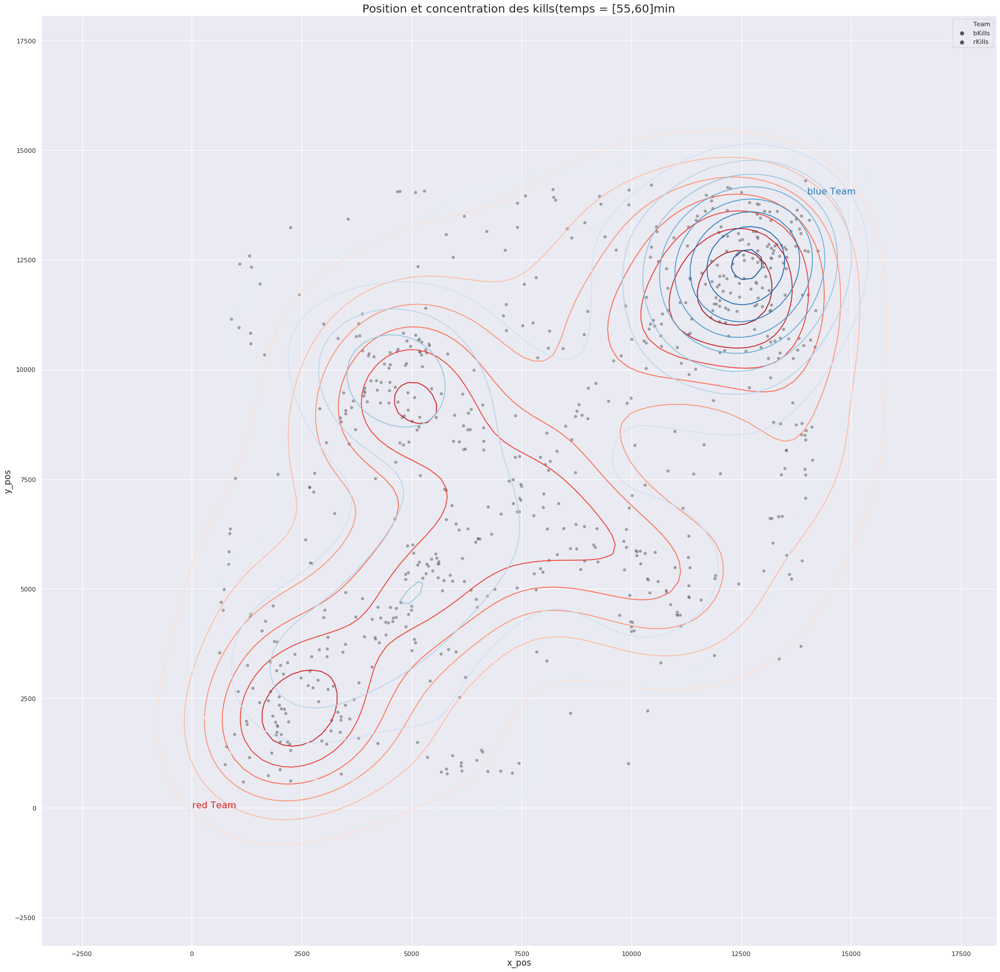

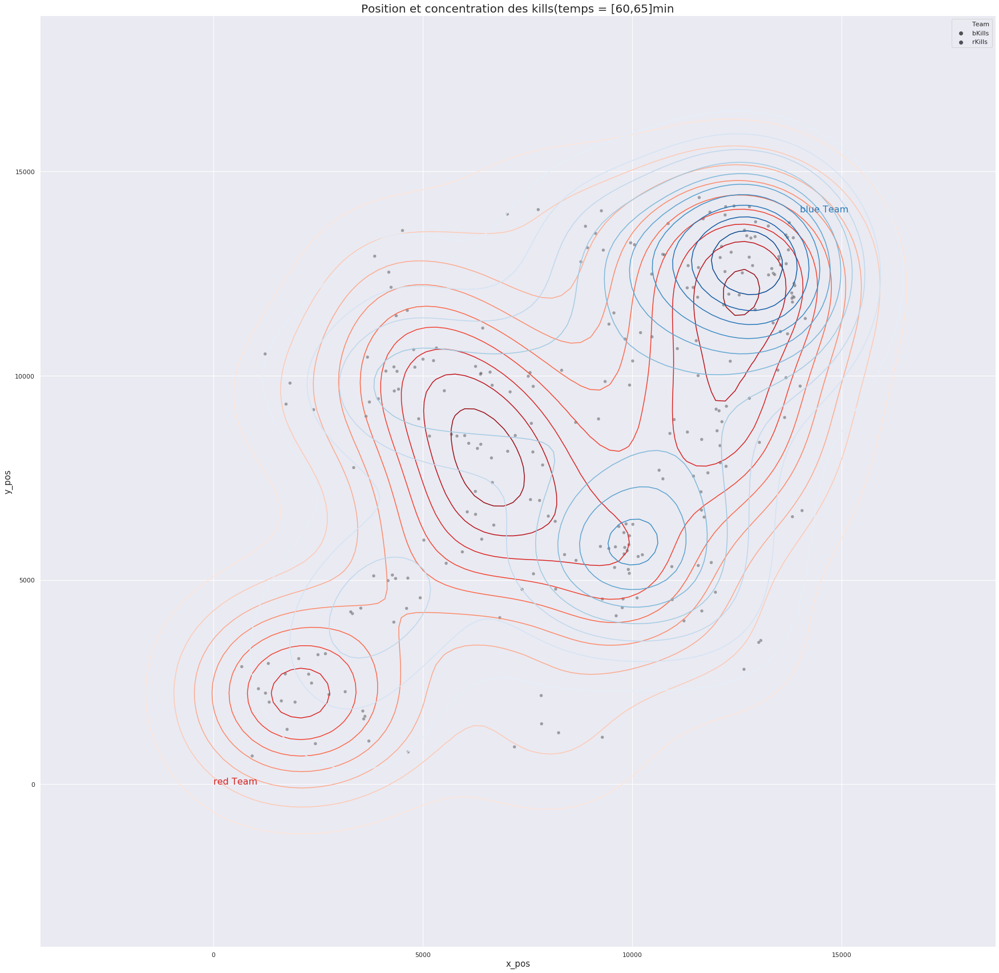

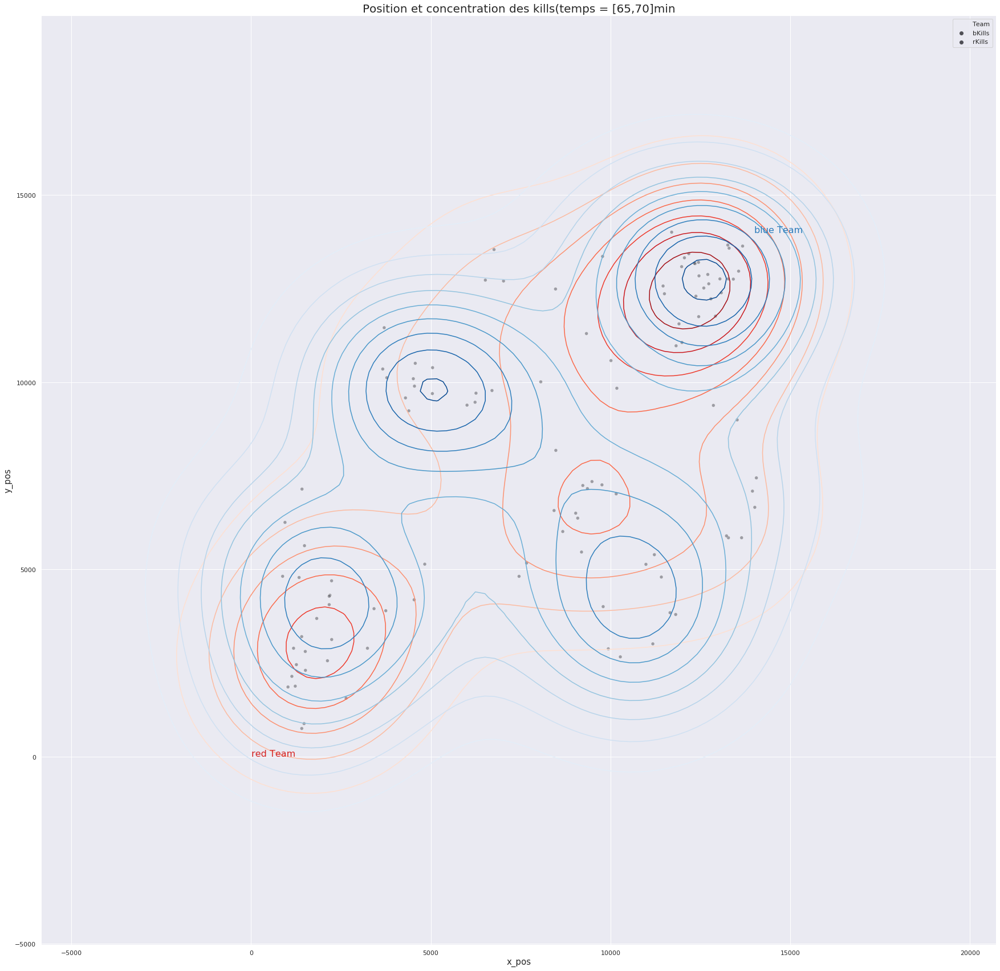

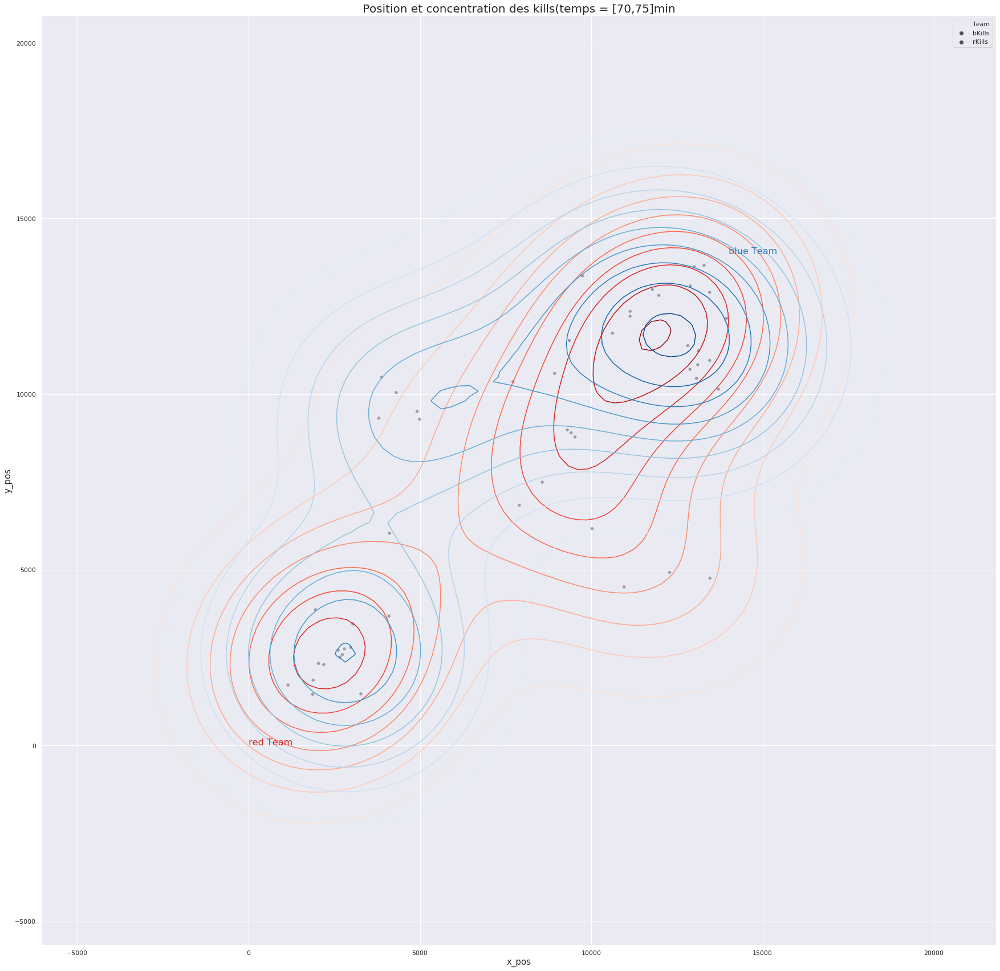

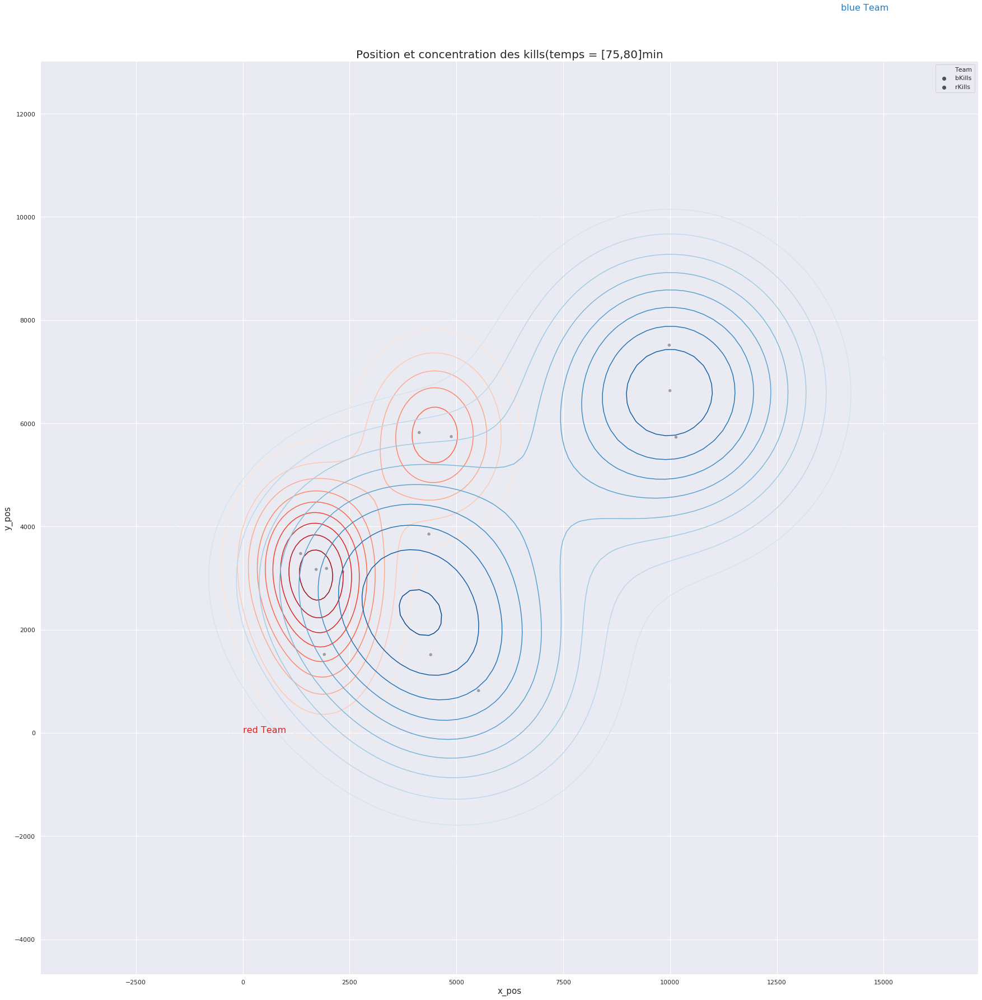

ValueError: The palette list has the wrong number of colors.

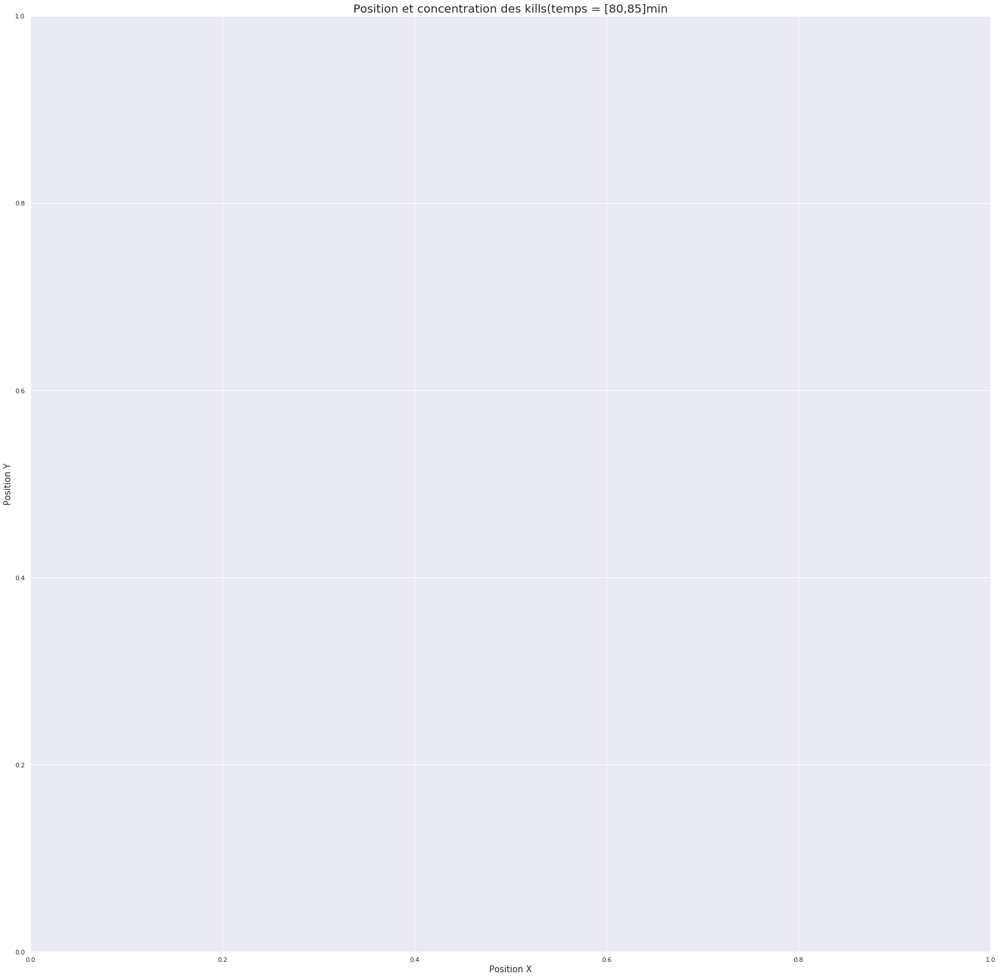

In [15]:
i = 0
j = 5

while i < 95:
    
    df_tempo = df[(df_position["Time"] <= j) & (df_position["Time"] > i )]

    f, ax = plt.subplots(figsize=(30,30))
    plt.title("Position et concentration des kills(temps = [{},{}]min".format(i,j),fontsize=20)
    plt.xlabel('Position X',fontsize=15)
    plt.ylabel('Position Y',fontsize=15)
    sns.despine(f, left=True, bottom=True)           
    flatui = ["#505057","#505057"]

    # Subset data
    red_team = df_tempo.query("Team == 'rKills'")
    blue_team = df_tempo.query("Team == 'bKills'")

    #Draw Scatterplot
    sns.scatterplot(x="x_pos", y="y_pos",
                    hue="Team", palette=flatui, data=df_tempo, ax=ax, alpha=0.5)

    # Draw the two density plots
    ax = sns.kdeplot(red_team.x_pos, red_team.y_pos,
                     cmap="Reds")

    ax = sns.kdeplot(blue_team.x_pos, blue_team.y_pos,
                     cmap="Blues")

    # # Add labels to the plot
    red = sns.color_palette("Reds")[-2]
    blue = sns.color_palette("Blues")[-2]
    ax.text(14000, 14000, "blue Team", size=16, color=blue)
    ax.text(3.8, 4.5, "red Team", size=16, color=red)
    plt.savefig("../../../cooedonnerKill{}-{}.png".format(i,j))
    plt.show()

    
    i += 5
    j += 5






/home/kozame/.local/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/kozame/.local/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


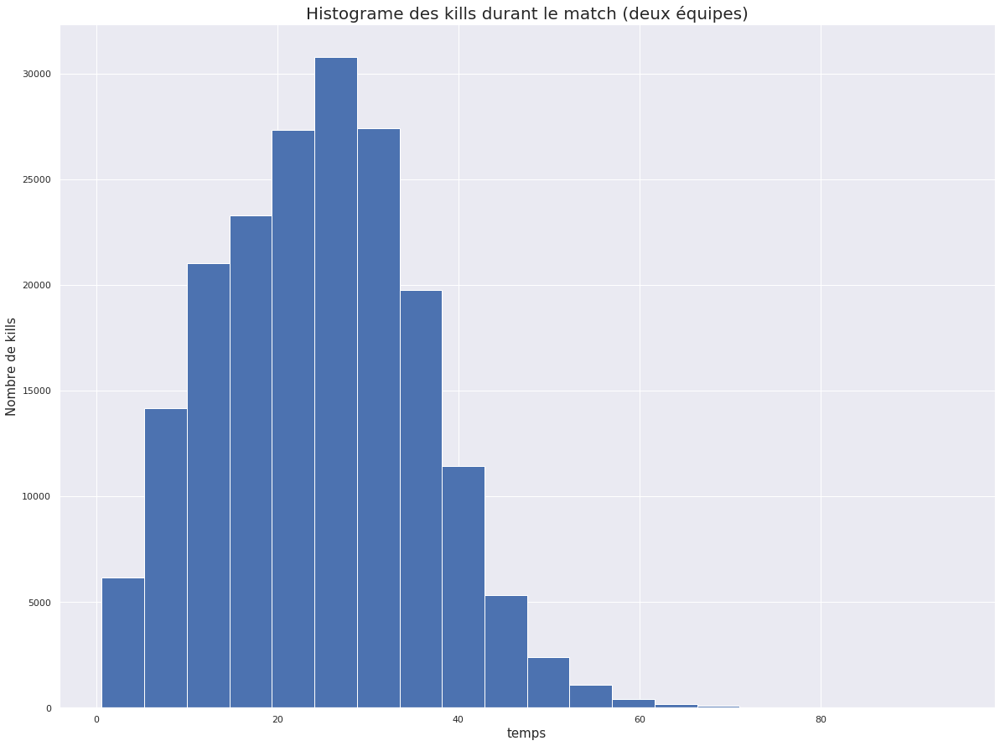

In [5]:
plt.figure(figsize=(20,15))
plt.title("Histograme des kills durant le match (deux équipes)",fontsize=20)
plt.xlabel("temps",fontsize=15)
plt.ylabel("Nombre de kills",fontsize=15)
plt.hist(df.Time, bins=20)
plt.savefig("../../../histoKill.png")
plt.show()

In [ ]:
année = df.Date.dt.year.min()
while année <= df.Date.dt.year.max():
    
    df_test = df[(df["Date"].dt.year == année)]

    red_team = df_test.query("Team == 'rKills'")
    blue_team = df_test.query("Team == 'bKills'")

    f, ax = plt.subplots(figsize=(30,30))
    sns.despine(f, left=True, bottom=True)
    flatui = ["#21282c","#21282c"]
    plt.title("Position kills année {}".format(année))
    plt.xlabel("Position X ")
    
    sns.scatterplot(x="x_pos", y="y_pos",hue="Team", palette=flatui, data=df_test, ax=ax, alpha=0.1)

    # Draw the two density plots
    ax = sns.kdeplot(red_team.x_pos, red_team.y_pos,
                     cmap="Reds")

    ax = sns.kdeplot(blue_team.x_pos, blue_team.y_pos,
                     cmap="Blues")

    # # Add labels to the plot
    red = sns.color_palette("Reds")[-2]
    blue = sns.color_palette("Blues")[-2]
    ax.text(14000, 15000, "Kills équipe Blue", size=16, color=blue)
    ax.text(3.8, 4.5, "Kills équipe Rouge", size=16, color=red)
    plt.show()
    année+=1